<a href="https://colab.research.google.com/github/rahelehmohseni/denoising/blob/main/U_Net_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import librosa
import numpy as np
import soundfile
import IPython
import shutil

In [ ]:
# Creating folder for all clean speech
!mkdir clean_sound

In [ ]:
!mkdir noise_sound

In [ ]:
def audio_to_audio_frame_stack(sound_data, frame_length, hop_length_frame):
    """This function take an audio and split into several frame
       in a numpy matrix of size (nb_frame,frame_length)"""

    sequence_sample_length = sound_data.shape[0]
    # Creating several audio frames using sliding windows
    sound_data_list = [sound_data[start:start + frame_length] for start in range(
    0, sequence_sample_length - frame_length + 1, hop_length_frame)]  # get sliding windows
    # Combining all the frames to single matrix
    sound_data_array = np.vstack(sound_data_list)
    return sound_data_array

In [ ]:
# Required variables for Audio
noise_dir = '/content/noise_sound'
voice_dir = '/content/clean_sound'
path_save_spectrogram = '/content/spectogram/'
sample_rate = 16000
min_duration = 1.0
frame_length = 8064
hop_length_frame = 8064
hop_length_frame_noise = 5000
nb_samples = 500
n_fft = 255
hop_length_fft = 63
dim_square_spec = int(n_fft / 2) + 1

In [ ]:
# clean Audio files
clean_audio_files = os.listdir(voice_dir)
# Selecting a random audio from clean speech
clean_random_audio = np.random.choice(clean_audio_files)
# Load Audio
y,sr = librosa.load('/content/clean_sound/1-1750.wav',sr=sample_rate)
# Converting to Audio to numpy matrix
clean = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Clean Audio: {}".format(clean_random_audio))
print("Shape:{}".format(clean.shape))

Clean Audio: 1-1750.wav
Shape:(119, 8064)


In [ ]:
# Noisy Audio files
noisy_audio_files = os.listdir(noise_dir)
# Selecting a random audio from noise data
noisy_random_audio = np.random.choice(noisy_audio_files)
# Load Audio
y,sr = librosa.load('/content/noise_sound/5-1750.wav',sr=sample_rate)
# Converting the Audio to numpy matrix
noise = audio_to_audio_frame_stack(y,frame_length,hop_length_frame)
print("Noise Audio: {}".format(noisy_random_audio))
print("Shape:{}".format(noise.shape))

Noise Audio: 5-1750.wav
Shape:(119, 8064)


In [ ]:
clean = np.vstack(clean)
noise = np.vstack(noise)

In [ ]:
def blend_noise_randomly(voice, noise, nb_samples, frame_length):
    """This function takes as input numpy arrays representing frames
    of voice sounds, noise sounds and the number of frames to be created
    and return numpy arrays with voice randomly blend with noise"""

    prod_voice = np.zeros((nb_samples, frame_length))
    prod_noise = np.zeros((nb_samples, frame_length))
    prod_noisy_voice = np.zeros((nb_samples, frame_length))

    for i in range(nb_samples):
        id_voice = np.random.randint(0, voice.shape[0])
        id_noise = np.random.randint(0, noise.shape[0])
        level_noise = np.random.uniform(0.2, 0.8)
        prod_voice[i, :] = voice[id_voice, :]
        prod_noise[i, :] = level_noise * noise[id_noise, :]
        prod_noisy_voice[i, :] = prod_voice[i, :] + prod_noise[i, :]

    return prod_voice, prod_noise, prod_noisy_voice

In [ ]:
prod_voice, prod_noise,prod_noisy_voice = blend_noise_randomly(voice=clean,noise=noise,nb_samples=10,frame_length=frame_length)

In [ ]:
samples_clean = []
samples_noisy_clean = []
for x in prod_voice:
  samples_clean.extend(x)

for x in prod_noisy_voice:
  samples_noisy_clean.extend(x)

In [ ]:
# After combining all samples to 1 (10*8064)
len(samples_clean)

80640

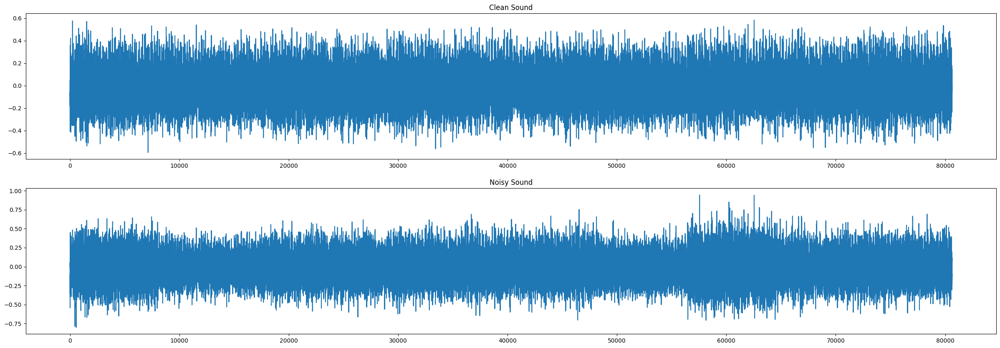

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(30,10))
plt.subplot(211)
plt.title("Clean Sound")
plt.plot(samples_clean)

plt.subplot(212)
plt.title("Noisy Sound")
plt.plot(samples_noisy_clean)

plt.show()

In [ ]:
# Saving and playing clean voice
import soundfile as sf
clean_nb_samples = prod_voice.shape[0]
#Save all frames in one file
clean_long = prod_voice.reshape(1, 10 * frame_length)*10
# librosa.output.write_wav(dir_save_prediction + audio_output_prediction, denoise_long[0, :], 1000)
sf.write("clean_long.wav", clean_long[0,:], 16000, 'PCM_24')

In [ ]:
from IPython.display import Audio
Audio('clean_long.wav')

In [ ]:
# Saving and playing noisy voice
noise_nb_samples = prod_noisy_voice.shape[0]
#Save all frames in one file
noise_long = prod_noisy_voice.reshape(1, 10 * frame_length)*10
# librosa.output.write_wav(dir_save_prediction + audio_output_prediction, denoise_long[0, :], 1000)
sf.write("noise_long.wav", noise_long[0,:], 16000, 'PCM_24')

In [ ]:
from IPython.display import Audio
Audio('noise_long.wav')

In [ ]:
def audio_to_magnitude_db_and_phase(n_fft, hop_length_fft, audio):
    """This function takes an audio and convert into spectrogram,
       it returns the magnitude in dB and the phase"""


    stftaudio = librosa.stft(audio, n_fft=n_fft, hop_length=hop_length_fft)
    stftaudio_magnitude, stftaudio_phase = librosa.magphase(stftaudio)

    stftaudio_magnitude_db = librosa.amplitude_to_db(
        stftaudio_magnitude, ref=np.max)

    return stftaudio_magnitude_db, stftaudio_phase


In [ ]:
def numpy_audio_to_matrix_spectrogram(numpy_audio, dim_square_spec, n_fft, hop_length_fft):
    """This function takes as input a numpy audi of size (nb_frame,frame_length), and return
    a numpy containing the matrix spectrogram for amplitude in dB and phase. It will have the size
    (nb_frame,dim_square_spec,dim_square_spec)"""

    # we extract the magnitude vectors from the 256-point STFT vectors and
    # take the first 129-point by removing the symmetric half.

    nb_audio = numpy_audio.shape[0]
    # dim_square_spec = 256/2
    m_mag_db = np.zeros((nb_audio, dim_square_spec, dim_square_spec))
    m_phase = np.zeros((nb_audio, dim_square_spec, dim_square_spec), dtype=complex)

    for i in range(nb_audio):
        m_mag_db[i, :, :], m_phase[i, :, :] = audio_to_magnitude_db_and_phase(
            n_fft, hop_length_fft, numpy_audio[i])

    return m_mag_db, m_phase

In [ ]:
def audio_files_to_numpy(audio_dir, list_audio_files, sample_rate, frame_length, hop_length_frame, min_duration):
    """This function take audio files of a directory and merge them
    in a numpy matrix of size (nb_frame,frame_length) for a sliding window of size hop_length_frame"""

    list_sound_array = []

    count = 0
    for file in list_audio_files:
    # open the audio file
      try:
        y, sr = librosa.load(os.path.join(audio_dir, file), sr=sample_rate)
        # Getting duration of audio file
        total_duration = librosa.get_duration(y=y, sr=sr)
      except ZeroDivisionError:
        count += 1

        # Check if the duration is atleast the minimum duration
      if (total_duration >= min_duration):
          list_sound_array.append(audio_to_audio_frame_stack(
              y, frame_length, hop_length_frame))
      else:
          print(
              f"The following file {os.path.join(audio_dir,file)} is below the min duration")

    return np.vstack(list_sound_array)

In [ ]:
#Data Prepare
def create_data(noise_dir, voice_dir,path_save_spectrogram, sample_rate,
min_duration, frame_length, hop_length_frame, hop_length_frame_noise, nb_samples, n_fft, hop_length_fft):
    """This function will randomly blend some clean voices from voice_dir with some noises from noise_dir
    and save the spectrograms of noisy voice, noise and clean voices to disk as well as complex phase,
    time series and sounds. This aims at preparing datasets for denoising training. It takes as inputs
    parameters defined in args module"""

    list_noise_files = os.listdir(noise_dir)
    list_voice_files = os.listdir(voice_dir)

    def remove_ds_store(lst):
        """remove mac specific file if present"""
        if '.DS_Store' in lst:
            lst.remove('.DS_Store')

        return lst

    list_noise_files = remove_ds_store(list_noise_files)
    list_voice_files = remove_ds_store(list_voice_files)

    nb_voice_files = len(list_voice_files)
    nb_noise_files = len(list_noise_files)


    # Extracting noise and voice from folder and convert to numpy
    noise = audio_files_to_numpy(noise_dir, list_noise_files, sample_rate,
                                     frame_length, hop_length_frame_noise, min_duration)

    voice = audio_files_to_numpy(voice_dir, list_voice_files,
                                     sample_rate, frame_length, hop_length_frame, min_duration)

    # Blend some clean voices with random selected noises (and a random level of noise)
    prod_voice, prod_noise, prod_noisy_voice = blend_noise_randomly(
            voice, noise, nb_samples, frame_length)


    # Squared spectrogram dimensions
    dim_square_spec = int(n_fft / 2) + 1

    # Create Amplitude and phase of the sounds
    m_amp_db_voice,  m_pha_voice = numpy_audio_to_matrix_spectrogram(
            prod_voice, dim_square_spec, n_fft, hop_length_fft)
    m_amp_db_noise,  m_pha_noise = numpy_audio_to_matrix_spectrogram(
            prod_noise, dim_square_spec, n_fft, hop_length_fft)
    m_amp_db_noisy_voice,  m_pha_noisy_voice = numpy_audio_to_matrix_spectrogram(
            prod_noisy_voice, dim_square_spec, n_fft, hop_length_fft)

    np.save(path_save_spectrogram + 'voice_amp_db', m_amp_db_voice)
    np.save(path_save_spectrogram + 'noise_amp_db', m_amp_db_noise)             #Not required
    np.save(path_save_spectrogram + 'noisy_voice_amp_db', m_amp_db_noisy_voice)


In [ ]:
# Creating folder save the audio spectograms
!mkdir spectogram

In [ ]:
noise_dir="/content/noise_sound"
voice_dir="/content/clean_sound"
path_save_spectrogram="/content/spectogram/"
sample_rate=16000
min_duration=1.0
frame_length=8064
hop_length_frame=8064
hop_length_frame_noise=5000
nb_samples=500
n_fft=255
hop_length_fft=63

In [ ]:
create_data(noise_dir=noise_dir,voice_dir=voice_dir,
            path_save_spectrogram=path_save_spectrogram,
            sample_rate=sample_rate,min_duration=min_duration,frame_length=frame_length,hop_length_frame=hop_length_frame,hop_length_frame_noise=hop_length_frame_noise,nb_samples=nb_samples,n_fft=n_fft,hop_length_fft=hop_length_fft)


In [ ]:
noisy_voice_amp_db = np.load('/content/spectogram/noisy_voice_amp_db.npy')
print(np.shape(noisy_voice_amp_db))

(500, 128, 128)


In [ ]:
import numpy as np
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, LeakyReLU, MaxPooling2D, Dropout, concatenate, UpSampling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend
import tensorflow as tf
# print(tf.__version__)

#Unet network
def unet(input_size = (128,128,1)):
    #size filter input
    size_filter_in = 16
    #normal initialization of weights
    kernel_init = 'he_normal'
    #To apply leaky relu after the conv layer
    activation_layer = None
    inputs = Input(input_size)
    conv1 = Conv2D(size_filter_in, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(inputs)
    conv1 = LeakyReLU()(conv1)
    conv1 = Conv2D(size_filter_in, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv1)
    conv1 = LeakyReLU()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(size_filter_in*2, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(pool1)
    conv2 = LeakyReLU()(conv2)
    conv2 = Conv2D(size_filter_in*2, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv2)
    conv2 = LeakyReLU()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(size_filter_in*4, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(pool2)
    conv3 = LeakyReLU()(conv3)
    conv3 = Conv2D(size_filter_in*4, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv3)
    conv3 = LeakyReLU()(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(size_filter_in*8, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(pool3)
    conv4 = LeakyReLU()(conv4)
    conv4 = Conv2D(size_filter_in*8, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv4)
    conv4 = LeakyReLU()(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(size_filter_in*16, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(pool4)
    conv5 = LeakyReLU()(conv5)
    conv5 = Conv2D(size_filter_in*16, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv5)
    conv5 = LeakyReLU()(conv5)
    drop5 = Dropout(0.5)(conv5)

    up6 = Conv2D(size_filter_in*8, 2, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(UpSampling2D(size = (2,2))(drop5))
    up6 = LeakyReLU()(up6)
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(size_filter_in*8, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(merge6)
    conv6 = LeakyReLU()(conv6)
    conv6 = Conv2D(size_filter_in*8, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv6)
    conv6 = LeakyReLU()(conv6)
    up7 = Conv2D(size_filter_in*4, 2, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(UpSampling2D(size = (2,2))(conv6))
    up7 = LeakyReLU()(up7)
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(size_filter_in*4, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(merge7)
    conv7 = LeakyReLU()(conv7)
    conv7 = Conv2D(size_filter_in*4, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv7)
    conv7 = LeakyReLU()(conv7)
    up8 = Conv2D(size_filter_in*2, 2, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(UpSampling2D(size = (2,2))(conv7))
    up8 = LeakyReLU()(up8)
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(size_filter_in*2, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(merge8)
    conv8 = LeakyReLU()(conv8)
    conv8 = Conv2D(size_filter_in*2, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv8)
    conv8 = LeakyReLU()(conv8)

    up9 = Conv2D(size_filter_in, 2, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(UpSampling2D(size = (2,2))(conv8))
    up9 = LeakyReLU()(up9)
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(size_filter_in, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(merge9)
    conv9 = LeakyReLU()(conv9)
    conv9 = Conv2D(size_filter_in, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv9)
    conv9 = LeakyReLU()(conv9)
    conv9 = Conv2D(2, 3, activation = activation_layer, padding = 'same', kernel_initializer = kernel_init)(conv9)
    conv9 = LeakyReLU()(conv9)
    conv10 = Conv2D(1, 1, activation = 'tanh')(conv9)

    model = Model(inputs,conv10)

    model.compile(optimizer = 'adam', loss = tf.keras.losses.MeanSquaredError(), metrics = ['mae'])
    #model.summary()
    return model

In [ ]:
def scaled_in(matrix_spec):
    "global scaling apply to noisy voice spectrograms (scale between -1 and 1)"
    matrix_spec = (matrix_spec + 46)/50
    return matrix_spec
def scaled_ou(matrix_spec):
    "global scaling apply to noise models spectrograms (scale between -1 and 1)"
    matrix_spec = (matrix_spec -6 )/82
    return matrix_spec

In [ ]:
noisy_voice = np.load("/content/spectogram/noisy_voice_amp_db.npy")
voice = np.load("/content/spectogram/noise_amp_db.npy")
noise = noisy_voice-voice


In [ ]:
# Shapes after reshaping
print(noisy_voice.shape)
print(noise.shape)

(500, 128, 128)
(500, 128, 128)


In [ ]:
# Input
noisy_voice = noisy_voice[:,:,:]
noisy_voice = noisy_voice.reshape(noisy_voice.shape[0],noisy_voice.shape[1],noisy_voice.shape[2],1)
# Output
noise = noise[:,:,:]
noise = noise.reshape(noise.shape[0],noise.shape[1],noise.shape[2],1)

In [ ]:
import matplotlib.pyplot as plt
import pandas
from tensorflow.keras.models import model_from_json
import numpy as np
from scipy import stats
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

def training_unet(path_save_spectrogram, weights_path, epochs, batch_size):
    """ This function will read noisy voice and clean voice spectrograms created by data_creation mode,
    and train a Unet model on this dataset for epochs and batch_size specified. It saves best models to disk regularly.
    """
    #load noisy voice & clean voice spectrograms created by data_creation mode
    X_in = np.load(path_save_spectrogram +'noisy_voice_amp_db'+".npy")
    X_ou = np.load(path_save_spectrogram +'voice_amp_db'+".npy")
    #Model of noise to predict
    X_ou = X_in - X_ou

    #Check distribution
    print(stats.describe(X_in.reshape(-1,1)))
    print(stats.describe(X_ou.reshape(-1,1)))

    #to scale between -1 and 1
    X_in = scaled_in(X_in)
    X_ou = scaled_ou(X_ou)

    #Check shape of spectrograms
    print(X_in.shape)
    print(X_ou.shape)
    #Check new distribution
    print(stats.describe(X_in.reshape(-1,1)))
    print(stats.describe(X_ou.reshape(-1,1)))


    #Reshape for training
    X_in = X_in[:,:,:]
    X_in = X_in.reshape(X_in.shape[0],X_in.shape[1],X_in.shape[2],1)
    X_ou = X_ou[:,:,:]
    X_ou = X_ou.reshape(X_ou.shape[0],X_ou.shape[1],X_ou.shape[2],1)
    # print(X_in.shape)
    # print(X_out.shape)

    X_train, X_test, y_train, y_test = train_test_split(X_in, X_ou, test_size=0.10, random_state=42)

    generator_nn=unet()

    #Save best models to disk during training
    checkpoint = ModelCheckpoint(weights_path+'/model_unet_best.h5', verbose=1, monitor='val_loss',save_best_only=True, mode='auto')

    generator_nn.summary()

    #Training
    history = generator_nn.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, shuffle=True, callbacks=[checkpoint], verbose=1, validation_data=(X_test, y_test))
    model_in_json = generator_nn.to_json()

    #Saving Model
    with open(weights_path+'model_unet.json','w') as json_file:
      json_file.write(model_in_json)

    #Plot training and validation loss (log scale)
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(loss) + 1)

    plt.plot(epochs, loss, label='Training loss')
    plt.plot(epochs, val_loss, label='Validation loss')
    plt.yscale('log')
    plt.title('Training and validation loss')
    plt.legend()
    plt.show()


In [ ]:
!mkdir weights

DescribeResult(nobs=8192000, minmax=(array([-80.]), array([0.])), mean=array([-23.75573047]), variance=array([99.90127806]), skewness=array([-1.71904188]), kurtosis=array([5.84328538]))
DescribeResult(nobs=8192000, minmax=(array([-66.11614337]), array([63.93578168])), mean=array([1.06478463]), variance=array([34.21686626]), skewness=array([0.25844726]), kurtosis=array([3.58836008]))
(500, 128, 128)
(500, 128, 128)
DescribeResult(nobs=8192000, minmax=(array([-0.68]), array([0.92])), mean=array([0.44488539]), variance=array([0.03996051]), skewness=array([-1.71904188]), kurtosis=array([5.84328538]))
DescribeResult(nobs=8192000, minmax=(array([-0.87946516]), array([0.70653392])), mean=array([-0.06018555]), variance=array([0.00508877]), skewness=array([0.25844726]), kurtosis=array([3.58836008]))
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to    

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


45/45 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0557
Epoch 2: val_loss improved from 0.00850 to 0.00754, saving model to ./weights/model_unet_best.h5
45/45 [==============================] - 2s 42ms/step - loss: 0.0058 - mae: 0.0557 - val_loss: 0.0075 - val_mae: 0.0657
Epoch 3/20
45/45 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0531
Epoch 3: val_loss improved from 0.00754 to 0.00669, saving model to ./weights/model_unet_best.h5
45/45 [==============================] - 2s 43ms/step - loss: 0.0053 - mae: 0.0531 - val_loss: 0.0067 - val_mae: 0.0622
Epoch 4/20
45/45 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0515
Epoch 4: val_loss improved from 0.00669 to 0.00654, saving model to ./weights/model_unet_best.h5
45/45 [==============================] - 2s 42ms/step - loss: 0.0050 - mae: 0.0515 - val_loss: 0.0065 - val_mae: 0.0624
Epoch 5/20
45/45 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0504
Epoc

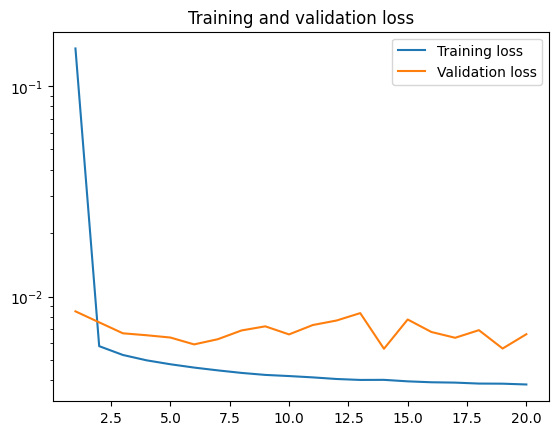

In [ ]:
training_unet(path_save_spectrogram, './weights', epochs=  20,batch_size=10)

In [ ]:
# Installing the Segmentation Library
!pip install git+https://github.com/qubvel/segmentation_models

  Cloning https://github.com/qubvel/segmentation_models to /tmp/pip-req-build-81r08rrj
  Running command git clone --filter=blob:none --quiet https://github.com/qubvel/segmentation_models /tmp/pip-req-build-81r08rrj
  Resolved https://github.com/qubvel/segmentation_models to commit e951c6747f75fa9e7240816d1c79dd2e66813123
  Running command git submodule update --init --recursive -q
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 811.1 kB/s eta 0:00:00
  Created wheel for segmentation-models: filename=segmentation_models-1.0.1-py3-none-any.whl size=33788 sha256=b67c90705633da0eb4e3f27a04c138681be26c50f58fb8a4d5ae3072391c86e9
  Stored in directory: /tmp/pip-ephem-wheel-cache-2r9nah9d/wheels/ce/d6/f1/5d00e82b3893c5f1ffee43bf7b8877148af09c7c9c6c4882c9
Successfully built segmentation-models


In [ ]:
import matplotlib.pyplot as plt
import pandas
from tensorflow.keras.models import model_from_json
import numpy as np
import tensorflow as tf
from scipy import stats
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

def training_2(path_save_spectrogram, weights_path, epochs, batch_size):
    """ This function will read noisy voice and clean voice spectrograms created by data_creation mode,
    and train a Unet model on this dataset for epochs and batch_size specified. It saves best models to disk regularly
    """
    #load noisy voice & clean voice spectrograms created by data_creation mode
    X_in = np.load(path_save_spectrogram +'noisy_voice_amp_db'+".npy")
    X_ou = np.load(path_save_spectrogram +'voice_amp_db'+".npy")
    #Model of noise to predict
    X_ou = X_in - X_ou

    #Check distribution
    print(stats.describe(X_in.reshape(-1,1)))
    print(stats.describe(X_ou.reshape(-1,1)))

    #to scale between -1 and 1
    X_in = scaled_in(X_in)
    X_ou = scaled_ou(X_ou)

    #Check shape of spectrograms
    print(X_in.shape)
    print(X_ou.shape)
    #Check new distribution
    print(stats.describe(X_in.reshape(-1,1)))
    print(stats.describe(X_ou.reshape(-1,1)))


    #Reshape for training
    X_in = X_in[:,:,:]
    X_in = X_in.reshape(X_in.shape[0],X_in.shape[1],X_in.shape[2],1)
    X_ou = X_ou[:,:,:]
    X_ou = X_ou.reshape(X_ou.shape[0],X_ou.shape[1],X_ou.shape[2],1)

    # X_train, X_test, y_train, y_test = train_test_split(X_in, X_ou, test_size=0.10, random_state=42)
    x_train, x_val, y_train, y_val = train_test_split(X_in, X_ou, test_size=0.10, random_state=42)

    import segmentation_models as sm
    from segmentation_models import Unet
    from keras.layers import Input, Conv2D
    from keras.models import Model

    # define number of channels
    N = x_train.shape[-1]

    base_model = Unet(backbone_name='resnet101', encoder_weights='imagenet')

    inp = Input(shape=(None, None, N))
    l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
    out = base_model(l1)

    model = Model(inp, out, name=base_model.name)
    BACKBONE = 'resnet101'
    preprocess_input = sm.get_preprocessing(BACKBONE)

    # preprocess input
    x_train = preprocess_input(x_train)
    x_val = preprocess_input(x_val)

    # define model
    model.compile(
    'Adam',
    loss = tf.keras.losses.MeanSquaredError(),
     metrics = ['mae']
    )

    # fitting model
    checkpoint = ModelCheckpoint(weights_path+'/model_ResNet.h5', verbose=1, monitor='val_loss',save_best_only=True, mode='auto')
    history = model.fit(
        x=x_train,
        y=y_train,
        batch_size=batch_size,
        epochs=epochs,
        validation_data=(x_val, y_val),
        callbacks=[checkpoint]
       )
    #Saving model in Json file
    model_in_json = model.to_json()
    with open('model_ResNet.json','w') as json_file:
      json_file.write(model_in_json)
    #Plot training and validation loss (log scale)
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(loss) + 1)

    plt.plot(epochs, loss, label='Training loss')
    plt.plot(epochs, val_loss, label='Validation loss')
    plt.yscale('log')
    plt.title('Training and validation loss')
    plt.legend()
    plt.show()

In [ ]:
!pip install -U -q segmentation-models
!pip install -q tensorflow==2.2.1
!pip install -q keras==2.5
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

from tensorflow import keras
import segmentation_models as sm

ERROR: Could not find a version that satisfies the requirement tensorflow==2.2.1 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.11.1, 2.12.0rc0, 2.12.0rc1, 2.12.0, 2.12.1, 2.13.0rc0, 2.13.0rc1, 2.13.0rc2, 2.13.0, 2.13.1, 2.14.0rc0, 2.14.0rc1, 2.14.0, 2.14.1, 2.15.0rc0, 2.15.0rc1, 2.15.0, 2.15.0.post1)
ERROR: No matching distribution found for tensorflow==2.2.1
ERROR: Could not find a version that satisfies the requirement keras==2.5 (from versions: 0.2.0, 0.3.0, 0.3.1, 0.3.2, 0.3.3, 1.0.0, 1.0.1, 1.0.2, 1.0.3, 1.0.4, 1.0.5, 1.0.6, 1.0.7, 1.0.8, 1.1.0, 1.1.1, 1.1.2, 1.2.0, 1.2.1, 1.2.2, 2.0.0, 2.0.1, 2.0.2, 2.0.3, 2.0.4, 2.0.5, 2.0.6, 2.0.7, 2.0.8, 2.0.9, 2.1.0, 2.1.1, 2.1.2, 2.1.3, 2.1.4, 2.1.5, 2.1.6, 2.2.0, 2.2.1, 2.2.2, 2.2.3, 2.2.4, 2.2.5, 2.3.0, 2.3.1, 2.4.0, 2.4.1, 2.4.2, 2.4.3, 2.5.0rc0, 2.6.0rc0,

DescribeResult(nobs=8192000, minmax=(array([-80.]), array([0.])), mean=array([-23.75573047]), variance=array([99.90127806]), skewness=array([-1.71904188]), kurtosis=array([5.84328538]))
DescribeResult(nobs=8192000, minmax=(array([-66.11614337]), array([63.93578168])), mean=array([1.06478463]), variance=array([34.21686626]), skewness=array([0.25844726]), kurtosis=array([3.58836008]))
(500, 128, 128)
(500, 128, 128)
DescribeResult(nobs=8192000, minmax=(array([-0.68]), array([0.92])), mean=array([0.44488539]), variance=array([0.03996051]), skewness=array([-1.71904188]), kurtosis=array([5.84328538]))
DescribeResult(nobs=8192000, minmax=(array([-0.87946516]), array([0.70653392])), mean=array([-0.06018555]), variance=array([0.00508877]), skewness=array([0.25844726]), kurtosis=array([3.58836008]))
171164896/171164896 [==============================] - 1s 0us/step
Epoch 1/20
45/45 [==============================] - ETA: 0s - loss: 0.0701 - mae: 0.2189
Epoch 1: val_loss improved from inf to 0.0

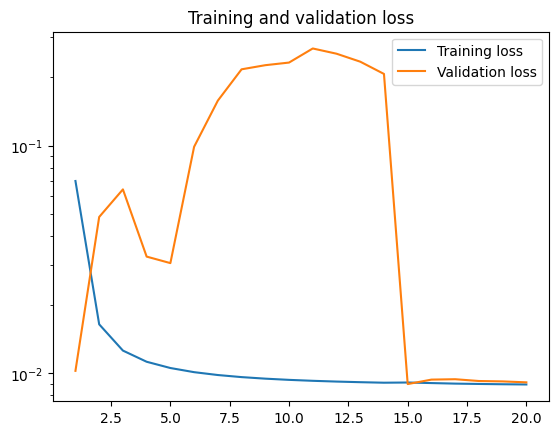

In [ ]:
training_2(path_save_spectrogram, './weights', epochs= 20,batch_size=10)

In [ ]:
# Downloading the best models .h5 and json file
!gdown 103NEFLrqrs8qOFG08RS2bkuMHPlhKTZU
!gdown 1--MnvC_MpsdU2giO8bhdWZA0HgPWR6se

Downloading...
From: https://drive.google.com/uc?id=103NEFLrqrs8qOFG08RS2bkuMHPlhKTZU
To: /content/Best_weight_Unet.h5
100% 23.6M/23.6M [00:00<00:00, 76.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1--MnvC_MpsdU2giO8bhdWZA0HgPWR6se
To: /content/Best_json_Unet.json
100% 26.1k/26.1k [00:00<00:00, 78.0MB/s]


In [ ]:
#Helper Functions
def magnitude_db_and_phase_to_audio(frame_length, hop_length_fft, stftaudio_magnitude_db, stftaudio_phase):
    """This functions reverts a spectrogram to an audio"""

    stftaudio_magnitude_rev = librosa.db_to_amplitude(stftaudio_magnitude_db, ref=1.0)

    # taking magnitude and phase of audio
    audio_reverse_stft = stftaudio_magnitude_rev * stftaudio_phase
    audio_reconstruct = librosa.core.istft(audio_reverse_stft, hop_length=hop_length_fft, length=frame_length)

    return audio_reconstruct


def matrix_spectrogram_to_numpy_audio(m_mag_db, m_phase, frame_length, hop_length_fft)  :
    """This functions reverts the matrix spectrograms to numpy audio"""

    list_audio = []

    nb_spec = m_mag_db.shape[0]

    for i in range(nb_spec):

        audio_reconstruct = magnitude_db_and_phase_to_audio(frame_length, hop_length_fft, m_mag_db[i], m_phase[i])
        list_audio.append(audio_reconstruct)

    return np.vstack(list_audio)

def inv_scaled_ou(matrix_spec):
    "inverse global scaling apply to noise models spectrograms"
    matrix_spec = matrix_spec * 82 + 6
    return matrix_spec

In [ ]:
import librosa
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import model_from_json
import soundfile as sf

def prediction(weights_path, audio_dir_prediction, dir_save_prediction, audio_input_prediction,
audio_output_prediction):
    """ This function takes as input pretrained weights, noisy voice sound to denoise, predict
    the denoise sound and save it to disk.
    """

    # load json and create model
    json_file = open('Best_json_Unet.json', 'r')
    loaded_model_json = json_file.read()
    json_file.close()
    loaded_model = model_from_json(loaded_model_json)
    # load weights into new model/
    loaded_model.load_weights('Best_weight_Unet.h5')
    print("Loaded model from disk")

    # Extracting noise and voice from folder and convert to numpy
    audio = audio_files_to_numpy(audio_dir_prediction, audio_input_prediction, sample_rate,
                                 frame_length, hop_length_frame, min_duration)

    #Dimensions of squared spectrogram
    dim_square_spec = int(n_fft / 2) + 1
    print(dim_square_spec)

    # Create Amplitude and phase of the sounds
    m_amp_db_audio,  m_pha_audio = numpy_audio_to_matrix_spectrogram(
        audio, dim_square_spec, n_fft, hop_length_fft)

    #global scaling to have distribution -1/1
    X_in = scaled_in(m_amp_db_audio)
    #Reshape for prediction
    X_in = X_in.reshape(X_in.shape[0],X_in.shape[1],X_in.shape[2],1)
    #Prediction using loaded network
    X_pred = loaded_model.predict(X_in)
    #Rescale back the noise model
    inv_sca_X_pred = inv_scaled_ou(X_pred)
    #Remove noise model from noisy speech
    X_denoise = m_amp_db_audio - inv_sca_X_pred[:,:,:,0]
    #Reconstruct audio from denoised spectrogram and phase
    print(X_denoise.shape)
    print(m_pha_audio.shape)
    print(frame_length)
    print(hop_length_fft)
    audio_denoise_recons = matrix_spectrogram_to_numpy_audio(X_denoise, m_pha_audio, frame_length, hop_length_fft)
    #Number of frames
    nb_samples = audio_denoise_recons.shape[0]
    #Save all frames in one file
    denoise_long = audio_denoise_recons.reshape(1, nb_samples * frame_length)*10
    # librosa.output.write_wav(dir_save_prediction + audio_output_prediction, denoise_long[0, :], 1000)
    sf.write(dir_save_prediction + audio_output_prediction, denoise_long[0, :], 16000, 'PCM_24')
    # wavfile.write(dir_save_prediction + audio_output_prediction, 1000, denoise_long[0,:])


In [ ]:

from IPython.display import Audio
Audio('7-1750.wav')

In [ ]:
prediction('/content', '/content', '/content/', ['/content/2-1750.wav'],'denoising2-1750.wav')

Loaded model from disk
128
4/4 [==============================] - 3s 459ms/step
(119, 128, 128)
(119, 128, 128)
8064
63


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
from IPython.display import Audio
Audio('denoising6.wav')

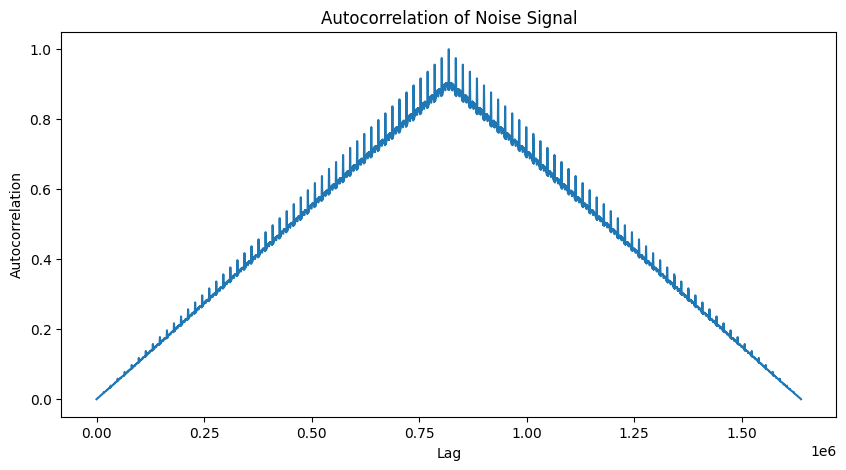

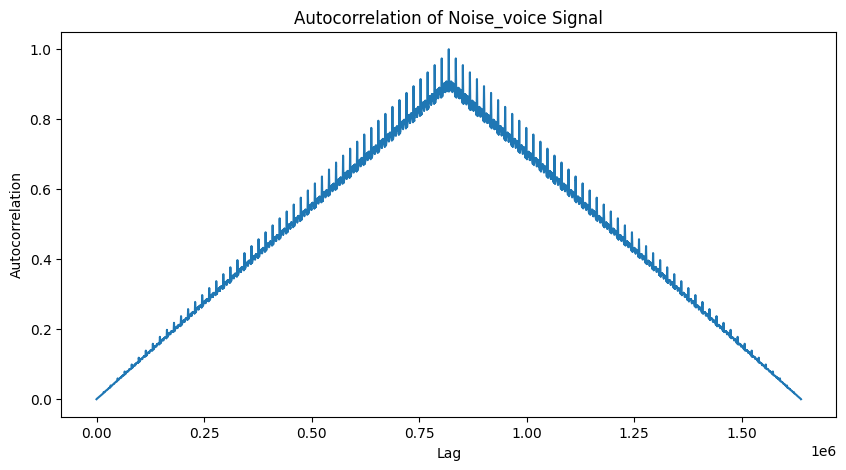

In [ ]:
import numpy as np
from scipy.signal import resample

# Downsample the signal
downsampling_factor = 10  # Adjust as needed
noise_voice_signal_downsampled = resample(noise_voice, len(noise_voice) // downsampling_factor)
voice_signal_downsampled = resample(voice, len(voice) // downsampling_factor)

# Ensure noise_signal_downsampled is a 1D array
noise_voice_signal_downsampled = noise_voice_signal_downsampled.flatten()
voice_signal_downsampled = voice_signal_downsampled.flatten()

# Calculate autocorrelation for downsampled signal
noise_voice_autocorr = np.correlate(noise_voice_signal_downsampled, noise_voice_signal_downsampled, mode='full')
voice_autocorr = np.correlate(voice_signal_downsampled, voice_signal_downsampled, mode='full')

# Normalize autocorrelation values
noise_voice_autocorr /= np.max(noise_voice_autocorr)
voice_autocorr /= np.max(voice_autocorr)

# Plot autocorrelation results
plt.figure(figsize=(10, 5))
plt.plot(noise_voice_autocorr)
plt.title('Autocorrelation of Noise_voice Signal')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(voice_autocorr)
plt.title('Autocorrelation of voice Signal')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

(819200,)
[-0.46666636  1.19577348  0.31496987 ... -2.39511901 -5.62028248
  4.2056832 ]


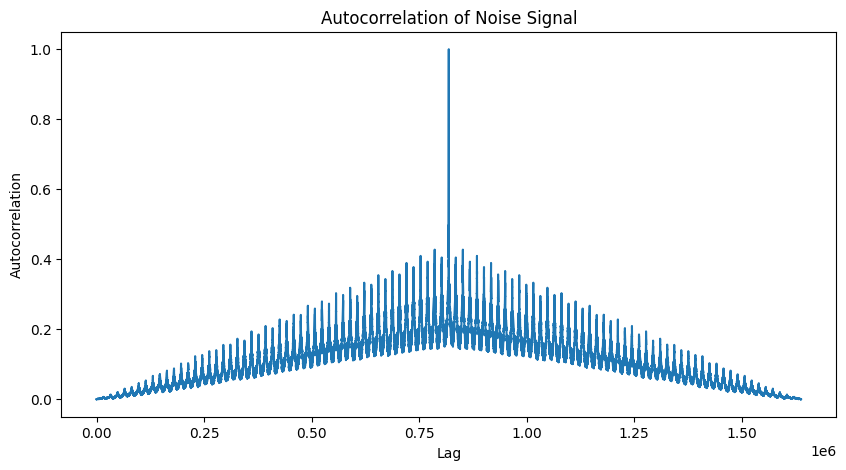

In [ ]:
import numpy as np
from scipy.signal import resample

# Downsample the signal
downsampling_factor = 10  # Adjust as needed
noise_signal_downsampled = resample(noise, len(noise) // downsampling_factor)

# Ensure noise_signal_downsampled is a 1D array
noise_signal_downsampled = noise_signal_downsampled.flatten()

# Calculate autocorrelation for downsampled signal
autocorr = np.correlate(noise_signal_downsampled, noise_signal_downsampled, mode='full')

# Normalize autocorrelation values
autocorr /= np.max(autocorr)


print(noise_signal_downsampled.shape)
print(noise_signal_downsampled)

# Plot autocorrelation results
plt.figure(figsize=(10, 5))
plt.plot(autocorr)
plt.title('Autocorrelation of Noise Signal')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

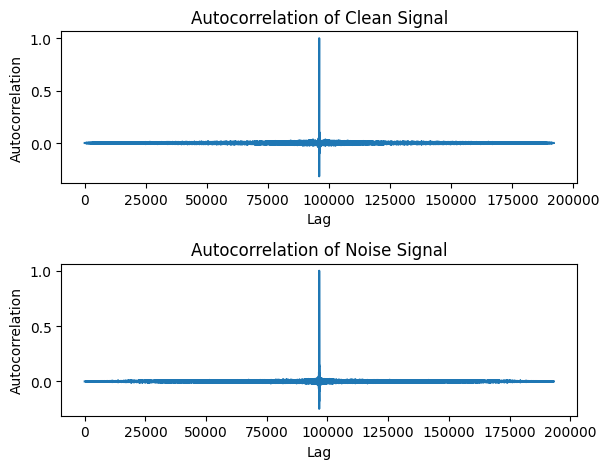

In [ ]:
import numpy as np
from scipy.signal import resample

clean_signal , sr_clean = librosa.load('/content/clean_speech/1-1300.wav', sr=sample_rate)
noise_signal, sr_noise = librosa.load('/content/noise/7-1300.wav', sr=sample_rate)
# Downsample the signal
downsampling_factor = 10  # Adjust as needed
clean_signal_downsampled = resample(clean_signal, len(clean_signal) // downsampling_factor)
noise_signal_downsampled = resample(noise_signal, len(noise_signal) // downsampling_factor)


# Ensure noise_signal_downsampled is a 1D array
clean_signal_downsampled = clean_signal_downsampled.flatten()
noise_signal_downsampled = noise_signal_downsampled.flatten()

# Calculate autocorrelation for downsampled signal
clean_autocorr = np.correlate(clean_signal_downsampled, clean_signal_downsampled, mode='full')
noise_autocorr = np.correlate(noise_signal_downsampled, noise_signal_downsampled, mode='full')

# Normalize autocorrelation values

clean_autocorr /= np.max(clean_autocorr)
noise_autocorr /= np.max(noise_autocorr)



plt.plot(clean_autocorr)
plt.title('Autocorrelation of Clean Signal')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.tight_layout()
plt.show()

plt.plot(noise_autocorr)
plt.title('Autocorrelation of Noise Signal')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.tight_layout()
plt.show()
